In [ ]:
#!pip install ultralytics

from ultralytics import YOLO
from IPython.display import Image, display
import os

# defining the home path
home_path = os.getcwd()

In [ ]:
# Dataset Waldo
#!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="FAyr6lIeTABff3HM9cqL")
project = rf.workspace("tan-rmi").project("whereiswaldo-ssmol")
dataset = project.version(3).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.124, to fix: `pip install ultralytics<=8.0.20`


Extracting Dataset Version Zip to WhereIsWaldo-3 in yolov8:: 100%|██████████| 1152/1152 [00:01<00:00, 932.82it/s] 


In [ ]:
model = YOLO('yolov8n.pt')
modelv1 = model.train(task = 'detect', model ="yolov8s.pt", data = f'{dataset.location}/data.yaml', epochs=100)


Ultralytics YOLOv8.0.124 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/WhereIsWaldo-3/data.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, fraction=1.0, profile=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False,

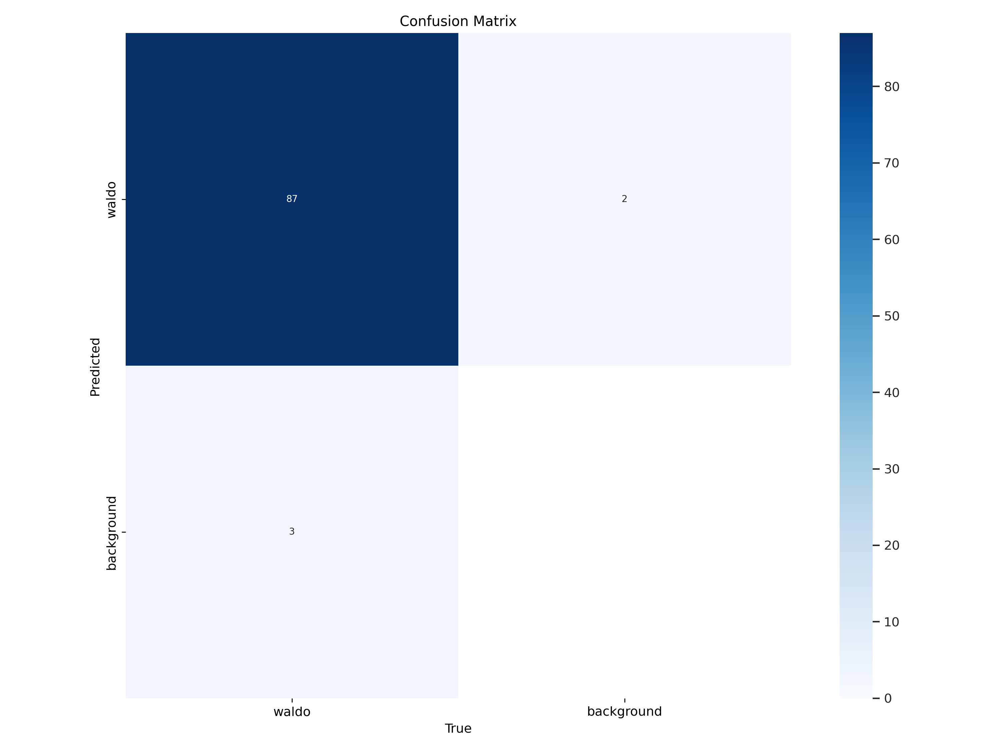

In [ ]:
Image(filename = f"{home_path}/runs/detect/train/confusion_matrix.png", width = 900)

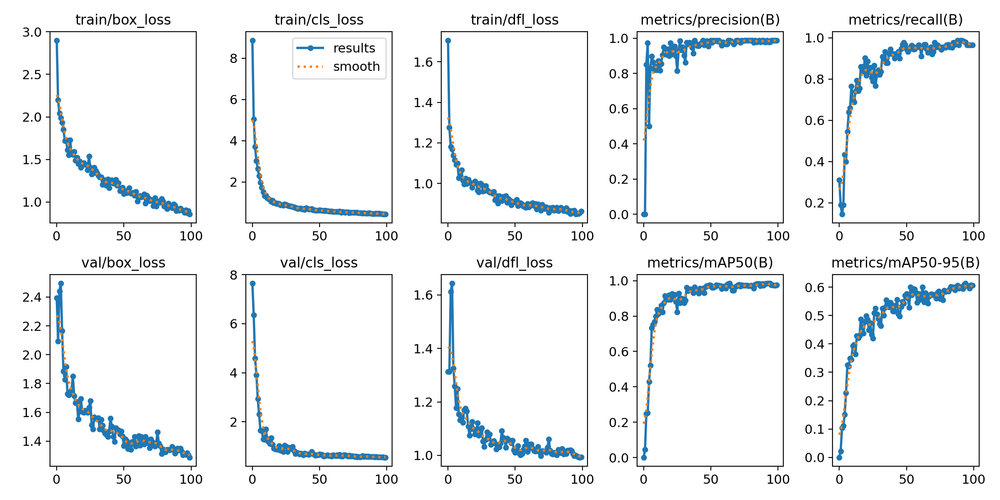

In [ ]:
Image(filename = f"{home_path}/runs/detect/train/results.png", width = 900)

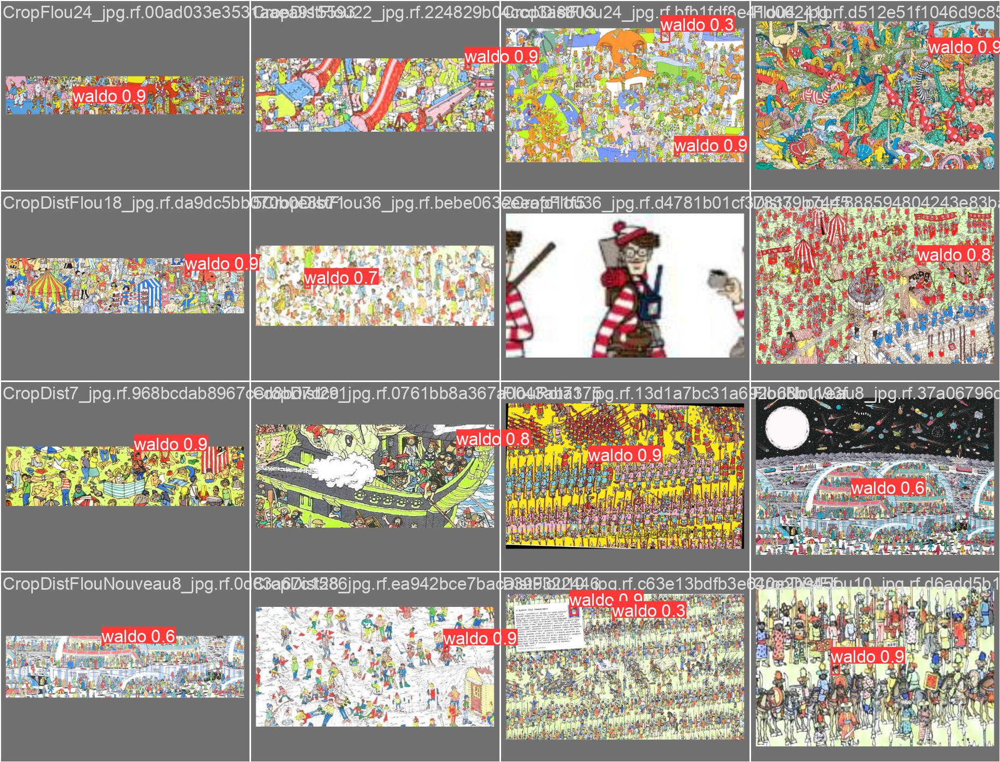

In [ ]:
Image(filename = f"{home_path}/runs/detect/train/val_batch0_pred.jpg", width = 900)

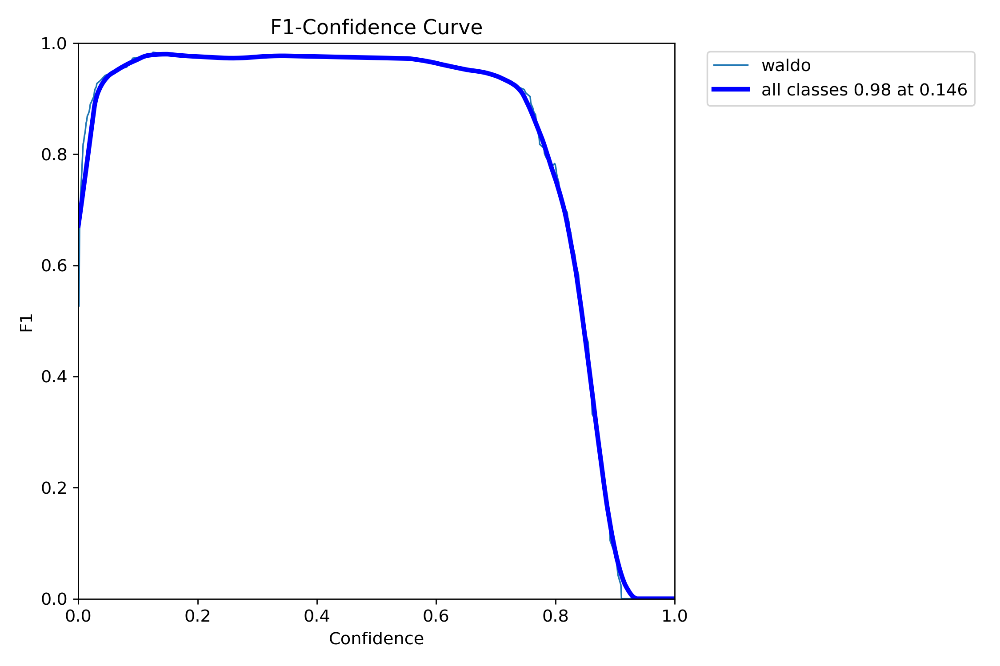

In [ ]:
Image(filename = f"{home_path}/runs/detect/train/F1_curve.png", width = 600)

### Validating

In [ ]:
val = model.val()

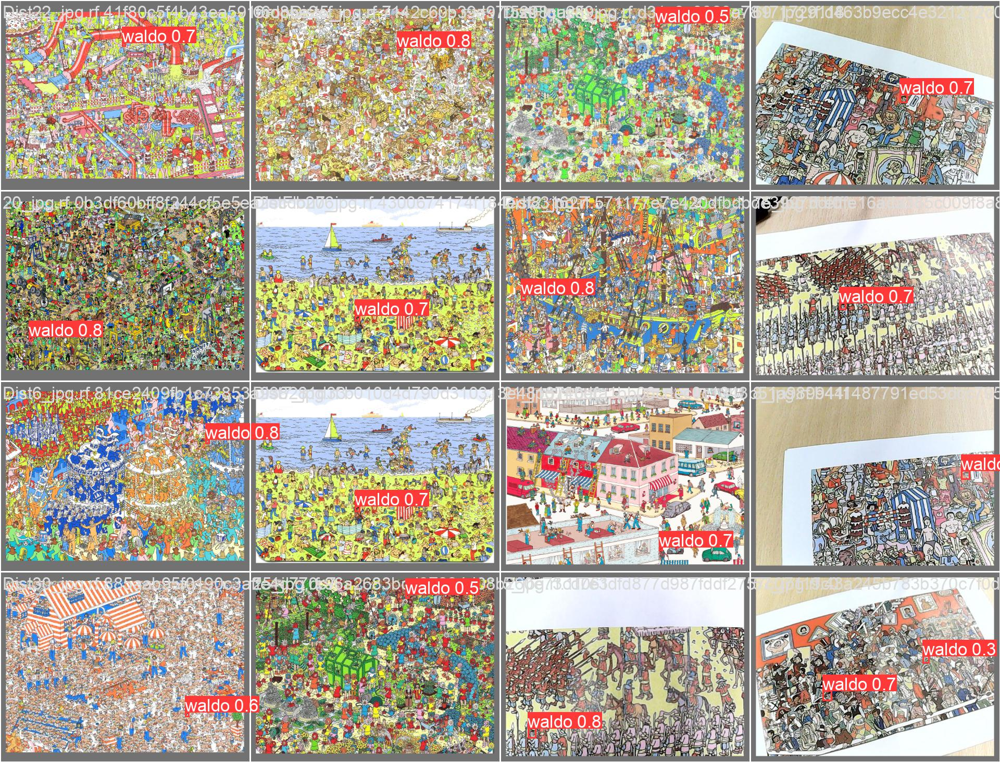

In [ ]:
# Displaying results
import glob

for imageName in glob.glob(f'{home_path}/runs/detect/val/*.jpg')[:1]:
    display(Image(filename=imageName))
    print('\n')

### Predicting

In [ ]:
predict = model.predict(task = 'detect', model = f'{home_path}/runs/train/weights/best.pt', source = f'{dataset.location}/test/images', save = True)


image 1/42 /content/WhereIsWaldo-3/test/images/100_jpg.rf.1616e71d543a64a69f8282685d2bc8bd.jpg: 480x640 1 waldo, 90.6ms
image 2/42 /content/WhereIsWaldo-3/test/images/104_jpg.rf.8e89f5a00b59137ad69e90aa48bebb52.jpg: 480x640 1 waldo, 8.3ms
image 3/42 /content/WhereIsWaldo-3/test/images/21_jpg.rf.32af5e8c6911b335eb13239b07375859.jpg: 480x640 (no detections), 7.5ms
image 4/42 /content/WhereIsWaldo-3/test/images/21_jpg.rf.4c57454584b78a932ba6d8104ad86a29.jpg: 480x640 1 waldo, 8.5ms
image 5/42 /content/WhereIsWaldo-3/test/images/22_jpg.rf.af26e62ced89ed6e11498b5bdfef165c.jpg: 480x640 1 waldo, 12.2ms
image 6/42 /content/WhereIsWaldo-3/test/images/26_jpg.rf.6856626bf03140d737e5ecf135b8798d.jpg: 480x640 1 waldo, 9.8ms
image 7/42 /content/WhereIsWaldo-3/test/images/30_jpg.rf.39dff7caac688ee24ff0c6d08c80dcfc.jpg: 480x640 1 waldo, 8.7ms
image 8/42 /content/WhereIsWaldo-3/test/images/37_jpg.rf.f334152058a5fc40967ad07fb39fa434.jpg: 480x640 1 waldo, 7.5ms
image 9/42 /content/WhereIsWaldo-3/test/ima

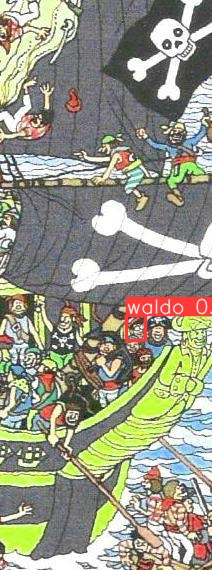

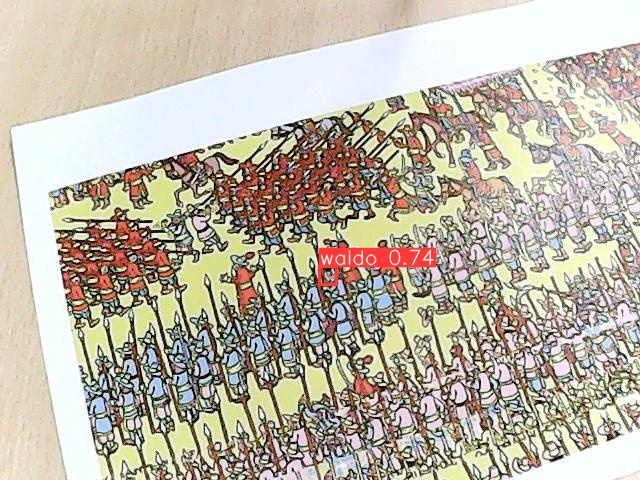

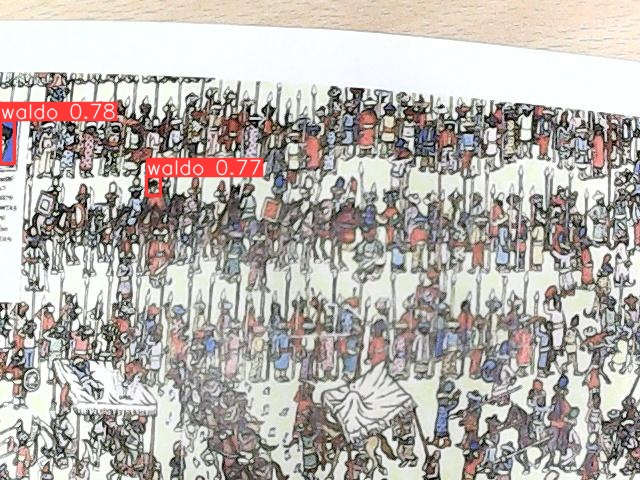

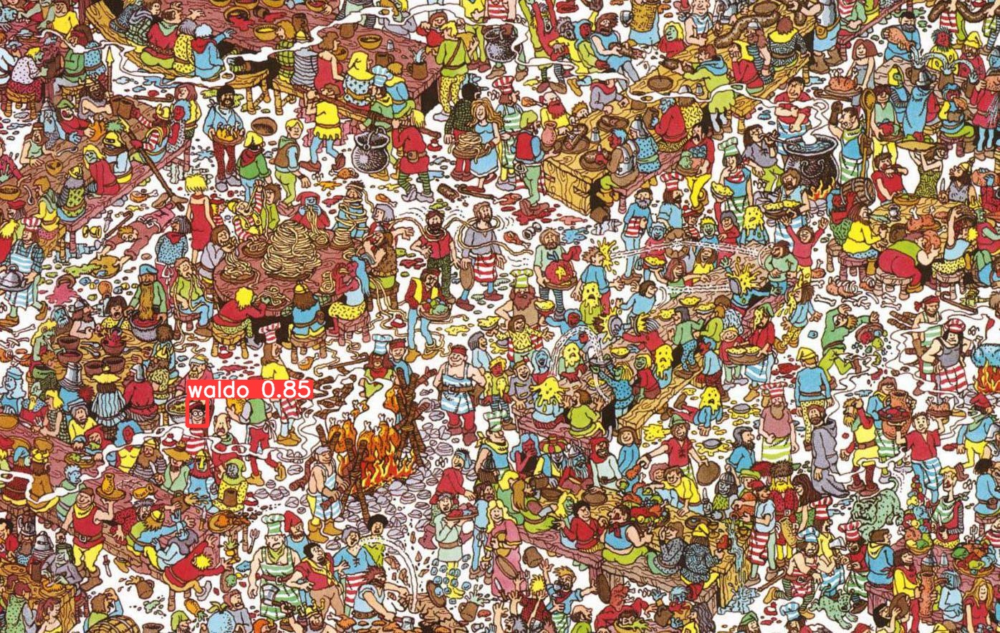

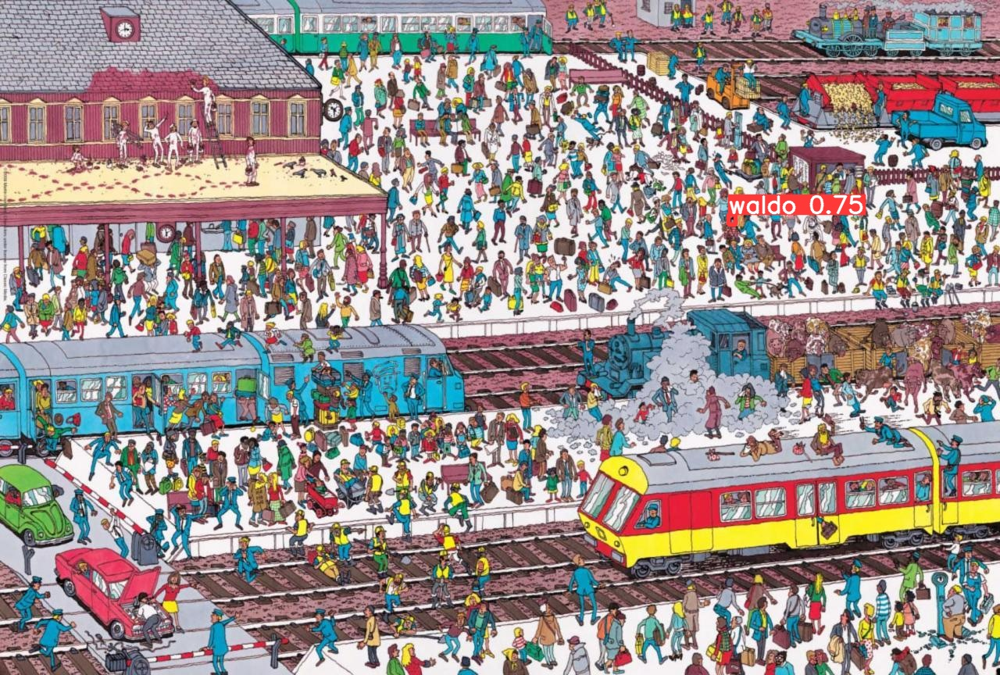

...

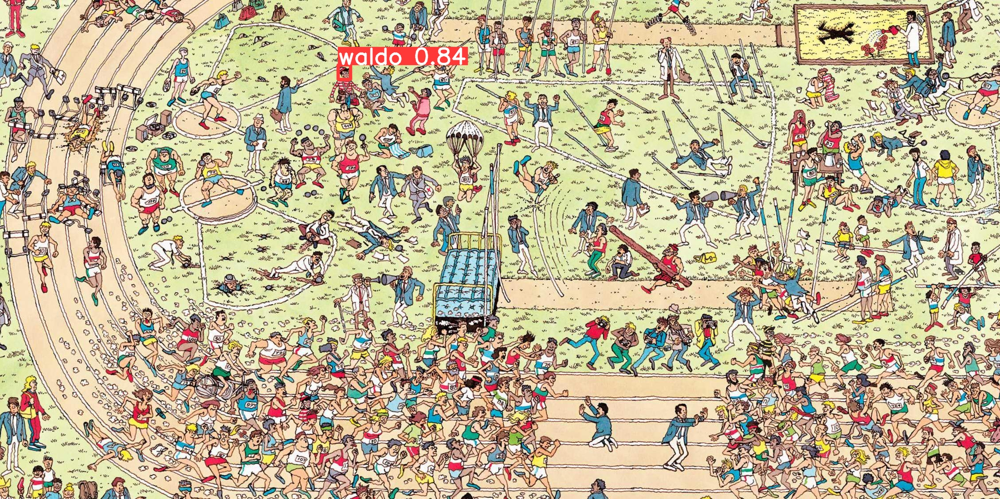

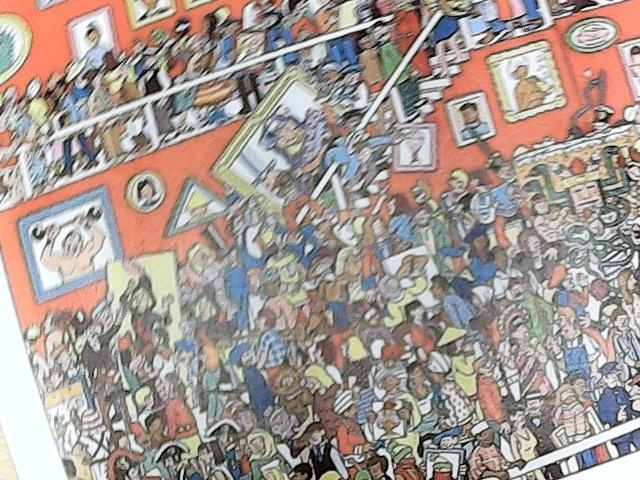

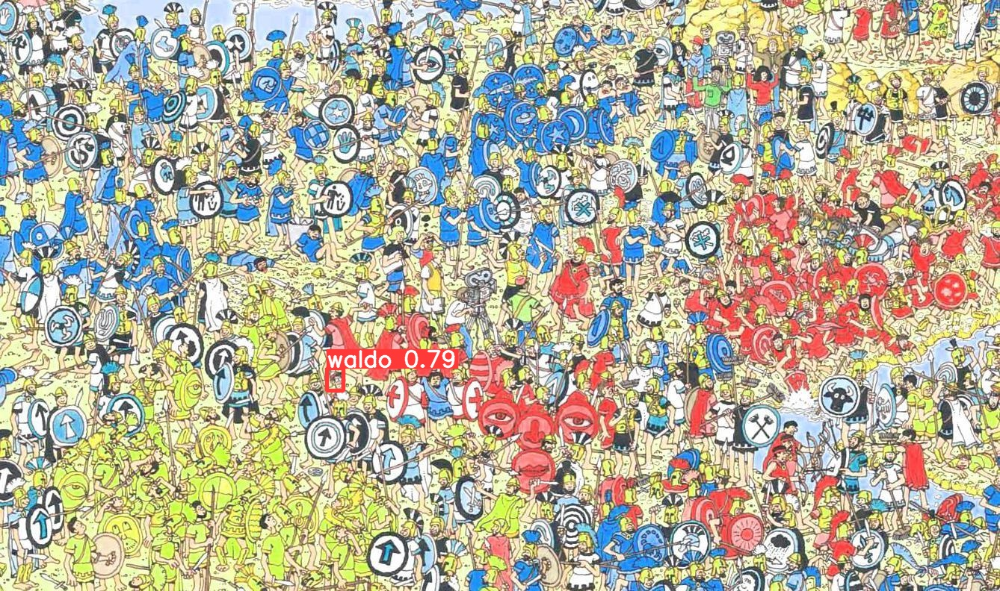

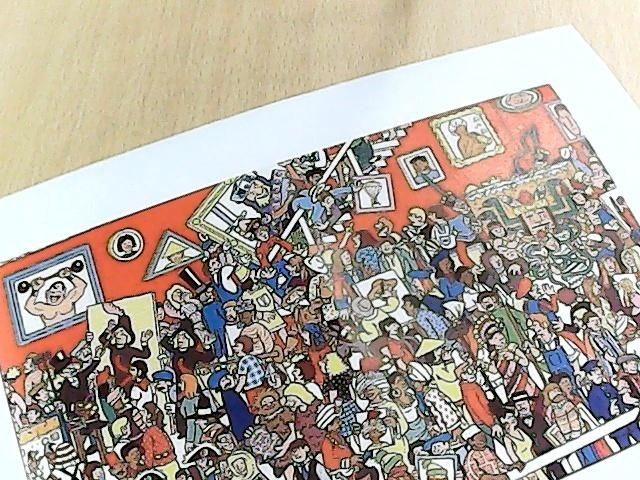

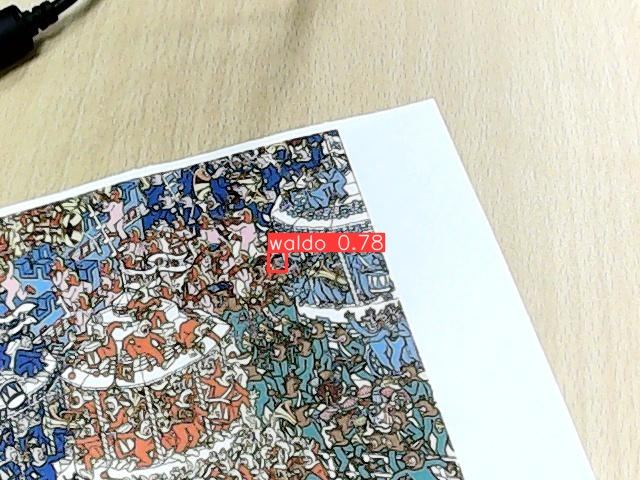

In [ ]:
# Display results
for imageName in glob.glob(f'{home_path}/runs/detect/predict/*.jpg'):
    display(Image(filename=imageName))
    print('\n')

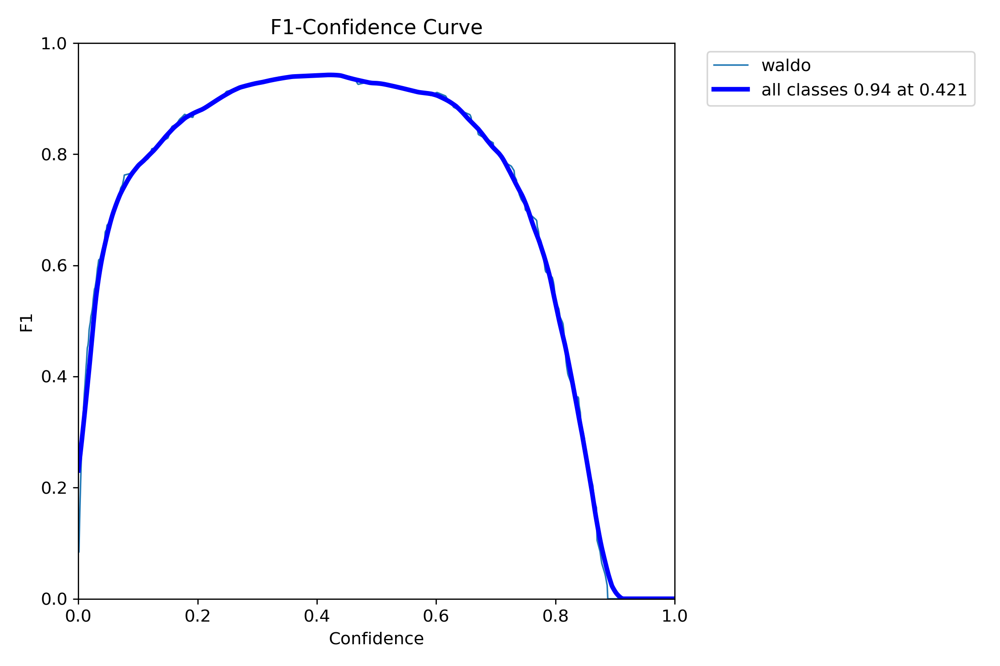

In [ ]:
Image(filename = f"{home_path}/runs/detect/val/F1_curve.png", width = 600)